# **CV Project: 3D Bounding Box Vehicle Detection in DashCam Videos**

# Import the libraries

In [1]:
import os
import glob as glob
import matplotlib.pyplot as plt
import cv2
import requests
import random
import numpy as np
import warnings
warnings.filterwarnings("ignore")

# Move to Python 3.8 version

In [2]:
!wget -O mini.sh https://repo.anaconda.com/miniconda/Miniconda3-py38_4.8.2-Linux-x86_64.sh
!chmod +x mini.sh
!bash ./mini.sh -b -f -p /usr/local
!conda install -q -y jupyter
!conda install -q -y google-colab -c conda-forge
!python -m ipykernel install --name "py38" --user

--2023-05-07 14:28:59--  https://repo.anaconda.com/miniconda/Miniconda3-py38_4.8.2-Linux-x86_64.sh
Resolving repo.anaconda.com (repo.anaconda.com)... 104.16.131.3, 104.16.130.3, 2606:4700::6810:8303, ...
Connecting to repo.anaconda.com (repo.anaconda.com)|104.16.131.3|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 89817099 (86M) [application/x-sh]
Saving to: ‘mini.sh’

mini.sh             100%[===================>]  85.66M   103MB/s    in 0.8s    

2023-05-07 14:29:00 (103 MB/s) - ‘mini.sh’ saved [89817099/89817099]

PREFIX=/usr/local
Unpacking payload ...
Solving environment: / - done

## Package Plan ##

  environment location: /usr/local

  added / updated specs:
    - _libgcc_mutex==0.1=main
    - asn1crypto==1.3.0=py38_0
    - ca-certificates==2020.1.1=0
    - certifi==2019.11.28=py38_0
    - cffi==1.14.0=py38h2e261b9_0
    - chardet==3.0.4=py38_1003
    - conda-package-handling==1.6.0=py38h7b6447c_0
    - conda==4.8.2=py38_0
    - cryptography==2.8=

In [3]:
import sys
print("User Current Version:-", sys.version)

User Current Version:- 3.10.11 (main, Apr  5 2023, 14:15:10) [GCC 9.4.0]


In [4]:
!python --version

Python 3.8.16


# Clone the Github Repository by 'ruhyadi'

In [5]:
!git clone https://github.com/ruhyadi/YOLO3D.git

Cloning into 'YOLO3D'...
remote: Enumerating objects: 738, done.
remote: Counting objects: 100% (105/105), done.
remote: Compressing objects: 100% (22/22), done.
remote: Total 738 (delta 90), reused 83 (delta 83), pack-reused 633
Receiving objects: 100% (738/738), 24.73 MiB | 37.24 MiB/s, done.
Resolving deltas: 100% (328/328), done.


# Download the Kitti Dataset images, labels and camera calibration files

In [6]:
!curl -L "https://s3.eu-central-1.amazonaws.com/avg-kitti/data_object_image_2.zip" > kitti.zip
!unzip kitti.zip -d YOLO3D/dataset/KITTI/
!rm kitti.zip

Streaming output truncated to the last 5000 lines.
 extracting: YOLO3D/dataset/KITTI/testing/image_2/004818.png  
 extracting: YOLO3D/dataset/KITTI/testing/image_2/003183.png  
 extracting: YOLO3D/dataset/KITTI/testing/image_2/007384.png  
 extracting: YOLO3D/dataset/KITTI/testing/image_2/002195.png  
 extracting: YOLO3D/dataset/KITTI/testing/image_2/002058.png  
 extracting: YOLO3D/dataset/KITTI/testing/image_2/006043.png  
 extracting: YOLO3D/dataset/KITTI/testing/image_2/006951.png  
 extracting: YOLO3D/dataset/KITTI/testing/image_2/002983.png  
 extracting: YOLO3D/dataset/KITTI/testing/image_2/007502.png  
 extracting: YOLO3D/dataset/KITTI/testing/image_2/007116.png  
 extracting: YOLO3D/dataset/KITTI/testing/image_2/006136.png  
 extracting: YOLO3D/dataset/KITTI/testing/image_2/006982.png  
 extracting: YOLO3D/dataset/KITTI/testing/image_2/000618.png  
 extracting: YOLO3D/dataset/KITTI/testing/image_2/005595.png  
 extracting: YOLO3D/dataset/KITTI/testing/image_2/000198.png  
 ext

In [7]:
!curl -L "https://s3.eu-central-1.amazonaws.com/avg-kitti/data_object_label_2.zip" > labels.zip
!unzip labels.zip -d YOLO3D/dataset/KITTI/
!rm labels.zip

Streaming output truncated to the last 5000 lines.
 extracting: YOLO3D/dataset/KITTI/training/label_2/001705.txt  
 extracting: YOLO3D/dataset/KITTI/training/label_2/000367.txt  
 extracting: YOLO3D/dataset/KITTI/training/label_2/006048.txt  
 extracting: YOLO3D/dataset/KITTI/training/label_2/005468.txt  
 extracting: YOLO3D/dataset/KITTI/training/label_2/007308.txt  
 extracting: YOLO3D/dataset/KITTI/training/label_2/001417.txt  
 extracting: YOLO3D/dataset/KITTI/training/label_2/006638.txt  
 extracting: YOLO3D/dataset/KITTI/training/label_2/002132.txt  
 extracting: YOLO3D/dataset/KITTI/training/label_2/002407.txt  
 extracting: YOLO3D/dataset/KITTI/training/label_2/007186.txt  
 extracting: YOLO3D/dataset/KITTI/training/label_2/004363.txt  
 extracting: YOLO3D/dataset/KITTI/training/label_2/005764.txt  
 extracting: YOLO3D/dataset/KITTI/training/label_2/003298.txt  
 extracting: YOLO3D/dataset/KITTI/training/label_2/002664.txt  
 extracting: YOLO3D/dataset/KITTI/training/label_2/00

In [8]:
!curl -L "https://s3.eu-central-1.amazonaws.com/avg-kitti/data_object_calib.zip" > calib.zip
!unzip calib.zip -d YOLO3D/dataset/KITTI/
!rm calib.zip

Streaming output truncated to the last 5000 lines.
 extracting: YOLO3D/dataset/KITTI/testing/calib/004249.txt  
 extracting: YOLO3D/dataset/KITTI/testing/calib/001148.txt  
 extracting: YOLO3D/dataset/KITTI/testing/calib/002994.txt  
 extracting: YOLO3D/dataset/KITTI/testing/calib/002335.txt  
 extracting: YOLO3D/dataset/KITTI/testing/calib/000689.txt  
 extracting: YOLO3D/dataset/KITTI/testing/calib/002782.txt  
 extracting: YOLO3D/dataset/KITTI/testing/calib/004242.txt  
 extracting: YOLO3D/dataset/KITTI/testing/calib/003661.txt  
 extracting: YOLO3D/dataset/KITTI/testing/calib/003118.txt  
 extracting: YOLO3D/dataset/KITTI/testing/calib/005423.txt  
 extracting: YOLO3D/dataset/KITTI/testing/calib/004621.txt  
 extracting: YOLO3D/dataset/KITTI/testing/calib/004649.txt  
 extracting: YOLO3D/dataset/KITTI/testing/calib/004048.txt  
 extracting: YOLO3D/dataset/KITTI/testing/calib/000601.txt  
 extracting: YOLO3D/dataset/KITTI/testing/calib/006901.txt  
 extracting: YOLO3D/dataset/KITTI/

# Visualise the Dataset

In [ ]:
train_dir = 'YOLO3D/dataset/KITTI/training/image_2/'
test_dir = 'YOLO3D/dataset/KITTI/testing/image_2/'
all_training_images = glob.glob(train_dir + '*.png')
all_testing_images = glob.glob(test_dir + '*.png')
num_train_images = len(all_training_images)
num_test_images = len(all_testing_images)

print('Number of Training Images:', num_train_images)
print('Number of Testing Images:', num_test_images)

Number of Training Images: 7481
Number of Testing Images: 7518


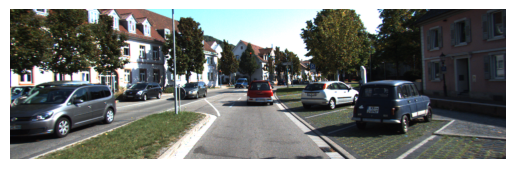

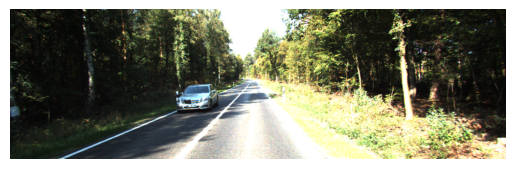

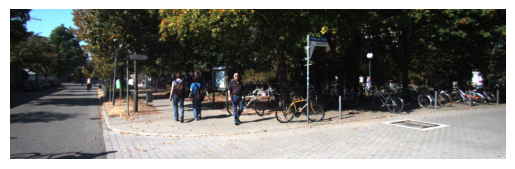

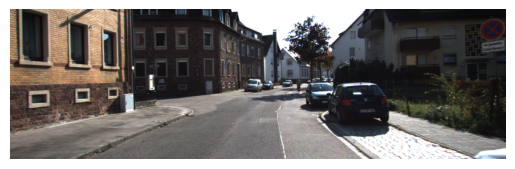

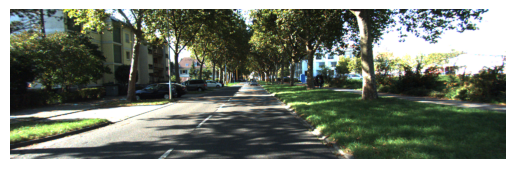

...

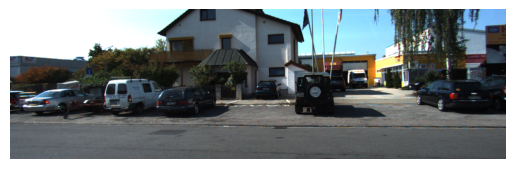

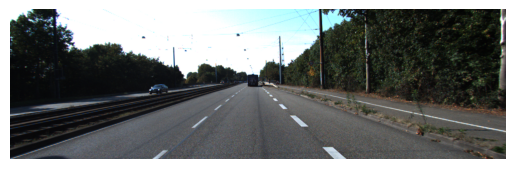

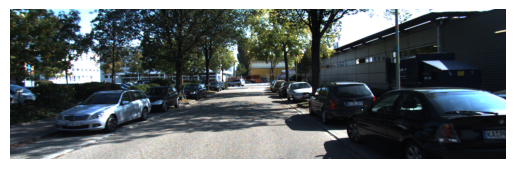

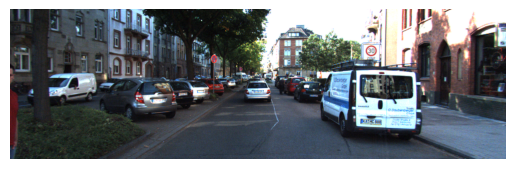

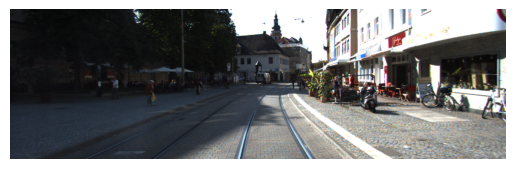

In [ ]:
num_samples = 20

for i in range(num_samples):
    j = random.randint(0,num_train_images-1)
    image = cv2.imread(all_training_images[j])
    plt.imshow(image[:, :, ::-1])
    plt.axis('off')
    plt.show()

# Install the required Dependencies

In [9]:
%cd YOLO3D/
! pwd

/content/YOLO3D
/content/YOLO3D


In [10]:
!pip install -r requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 719 kB 4.9 MB/s 
     |████████████████████████████████| 9.2 MB 49.4 MB/s 
     |████████████████████████████████| 61.8 MB 122 kB/s 
     |████████████████████████████████| 3.3 MB 69.9 MB/s 
     |████████████████████████████████| 701 kB 71.5 MB/s 
     |████████████████████████████████| 62 kB 1.2 MB/s 
     |████████████████████████████████| 34.5 MB 1.2 MB/s 
     |████████████████████████████████| 96 kB 7.4 MB/s 
     |████████████████████████████████| 242 kB 74.9 MB/s 
     |████████████████████████████████| 5.6 MB 62.8 MB/s 
     |████████████████████████████████| 506 kB 61.8 MB/s 
     |████████████████████████████████| 293 kB 61.3 MB/s 
     |████████████████████████████████| 153 kB 77.1 MB/s 
     |████████████████████████████████| 619.9 MB 24 kB/s 
     |████████████████████████████████| 519 kB 62.7 MB/s 
     |██████████████████████████████

In [11]:
!pip install torch==1.8.1 torchvision==0.9.1

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 804.1 MB 5.5 kB/s 
     |████████████████████████████████| 17.4 MB 64.0 MB/s 
ERROR: pytorch-lightning 2.0.2 has requirement torch>=1.11.0, but you'll have torch 1.8.1 which is incompatible.
ERROR: pytorch-lightning 2.0.2 has requirement tqdm>=4.57.0, but you'll have tqdm 4.42.1 which is incompatible.
  Attempting uninstall: torch
    Found existing installation: torch 2.0.0
    Uninstalling torch-2.0.0:
      Successfully uninstalled torch-2.0.0


# Train the Models for 3D Bound Box Detection

## Load the Model Weights

In [12]:
!python weights/get_weights.py --weights resnet18
!python weights/get_weights.py --weights vgg11

Downloading...
From (uriginal): https://drive.google.com/uc?id=1k_v1RrDO6da_NDhBtMZL5c0QSogCmiRn
From (redirected): https://drive.google.com/uc?id=1k_v1RrDO6da_NDhBtMZL5c0QSogCmiRn&confirm=t&uuid=f24a9a3f-cbf3-43f6-933a-5de90d65ae05
To: /content/YOLO3D/resnet18.pkl
100% 298M/298M [00:02<00:00, 112MB/s]
Downloading...
From (uriginal): https://drive.google.com/uc?id=1vZcB-NaPUCovVA-pH-g-3NNJuUA948ni
From (redirected): https://drive.google.com/uc?id=1vZcB-NaPUCovVA-pH-g-3NNJuUA948ni&confirm=t&uuid=db49fb84-9279-4d64-a983-022dcb0ac1ef
To: /content/YOLO3D/vgg11.pkl
100% 230M/230M [00:05<00:00, 38.4MB/s]


## Training the Model

In [ ]:
!python train.py \
    --epochs 10 \
    --batch_size 32 \
    --num_workers 2 \
    --save_epoch 5 \
    --train_path ./dataset/KITTI/training \
    --model_path ./weights \
    --select_model resnet18 \
    --api_key L2gBawr6dEWfcyLqqm6wkGNVi

Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /root/.cache/torch/hub/checkpoints/resnet18-5c106cde.pth
100% 44.7M/44.7M [00:00<00:00, 73.1MB/s]
Downloading: "https://download.pytorch.org/models/vgg11-bbd30ac9.pth" to /root/.cache/torch/hub/checkpoints/vgg11-bbd30ac9.pth
100% 507M/507M [00:06<00:00, 76.1MB/s]
[INFO] Loading dataset...
COMET WARNING: To get all data logged automatically, import comet_ml before the following modules: tensorboard, torch.
COMET INFO: Experiment is live on comet.com https://www.comet.com/devkhush/yolo3d/59204b458d2d4d18ac751673b2e6a884

COMET WARNING: Error exporting current conda environment
Epoch 5: 100%|██████████| 1268/1268 [08:27<00:00,  2.50batch/s, loss=-.236]
[INFO] Saving weights as ./weights/resnet18_epoch_5.pkl
Epoch 10: 100%|██████████| 1268/1268 [08:22<00:00,  2.52batch/s, loss=-.301]
[INFO] Saving weights as ./weights/resnet18_epoch_10.pkl
COMET INFO: ----------------------------------------------------------------

## Test the Resnet-18 Model on Validation set

In [ ]:
!python inference.py \
  --weights yolov5s.pt \
  --source eval/image_2/ \
  --reg_weights resnet18.pkl \
  --model_select resnet18 \
  --output_path runs01 \
  --save_result

inference: weights=['yolov5s.pt'], source=eval/image_2/, data=data/coco128.yaml, imgsz=[640, 640], device=, classes=[0, 2, 3, 5], reg_weights=resnet18.pkl, model_select=resnet18, calib_file=eval/camera_cal/calib_cam_to_cam.txt, show_result=False, save_result=True, output_path=runs01
YOLOv5 🚀 bce4c23 torch 1.8.1+cu102 CUDA:0 (Tesla T4, 15102MiB)

100% 14.1M/14.1M [00:00<00:00, 182MB/s]

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/YOLO3D/eval/image_2/000010.png: 224x640 13 cars, Done. (0.017s)
Speed: 0.6ms pre-process, 17.2ms inference, 31.9ms NMS per image at shape (1, 3, 640, 640)
YOLOv5 🚀 bce4c23 torch 1.8.1+cu102 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/YOLO3D/eval/image_2/000036.png: 224x640 11 cars, Done. (0.018s)
Speed: 0.4ms pre-process, 18.3ms inference, 4.1ms NMS per image at shape (1, 3, 640, 640)
YOLOv5 🚀 bce4c23 tor

## Test the VGG-11 Model on Validation set

In [ ]:
!python inference.py \
  --weights yolov5s.pt \
  --source eval/image_2/ \
  --reg_weights vgg11.pkl \
  --model_select vgg11 \
  --output_path runs02 \
  --save_result

inference: weights=['yolov5s.pt'], source=eval/image_2/, data=data/coco128.yaml, imgsz=[640, 640], device=, classes=[0, 2, 3, 5], reg_weights=vgg11.pkl, model_select=vgg11, calib_file=eval/camera_cal/calib_cam_to_cam.txt, show_result=False, save_result=True, output_path=runs02
YOLOv5 🚀 bce4c23 torch 1.8.1+cu102 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/YOLO3D/eval/image_2/000010.png: 224x640 13 cars, Done. (0.012s)
Speed: 0.4ms pre-process, 12.5ms inference, 2.4ms NMS per image at shape (1, 3, 640, 640)
YOLOv5 🚀 bce4c23 torch 1.8.1+cu102 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/YOLO3D/eval/image_2/000036.png: 224x640 11 cars, Done. (0.013s)
Speed: 0.4ms pre-process, 13.2ms inference, 1.9ms NMS per image at shape (1, 3, 640, 640)
YOLOv5 🚀 bce4c23 torch 1.8.1+cu102 CUDA:0 (Tesla T4, 15102MiB)

Fusi

## Visualize the Resnet-18 Validation Predictions

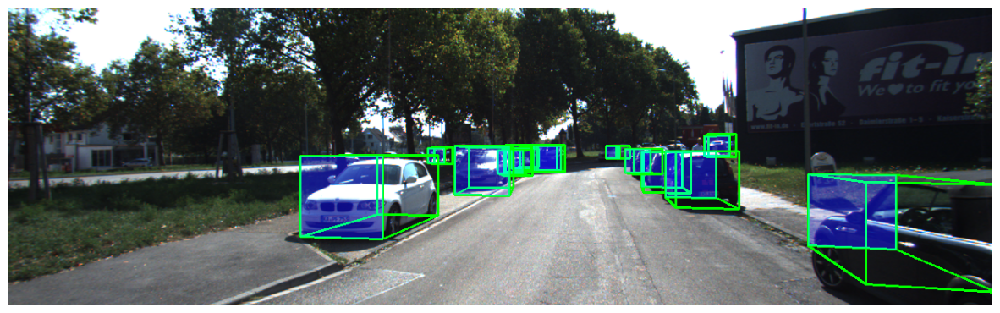

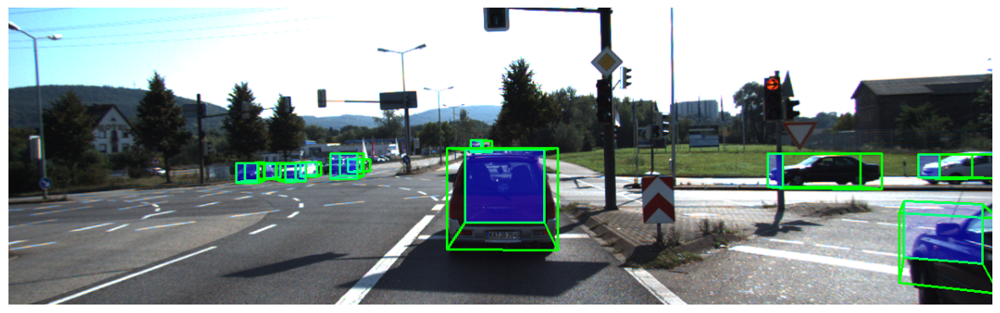

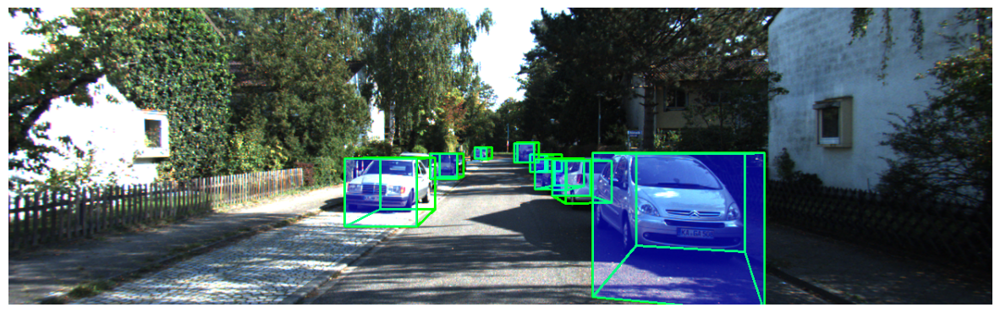

In [ ]:
import cv2
import matplotlib.pyplot as plt

img = cv2.cvtColor(cv2.imread('/content/YOLO3D/runs01/000.png'), cv2.COLOR_BGR2RGB)
plt.figure(figsize=(15, 8))
plt.imshow(img)
plt.axis('off')
plt.show()
img = cv2.cvtColor(cv2.imread('/content/YOLO3D/runs01/001.png'), cv2.COLOR_BGR2RGB)
plt.figure(figsize=(15, 8))
plt.imshow(img)
plt.axis('off')
plt.show()
img = cv2.cvtColor(cv2.imread('/content/YOLO3D/runs01/002.png'), cv2.COLOR_BGR2RGB)
plt.figure(figsize=(15, 8))
plt.imshow(img)
plt.axis('off')
plt.show()

## Visualize the VGG-11 Validation Predictions

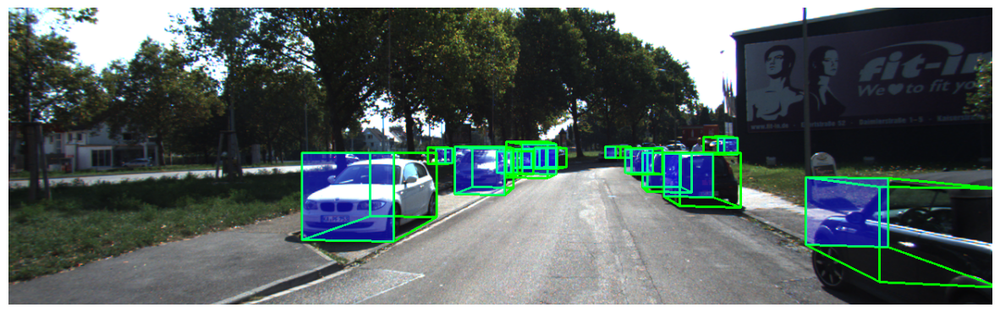

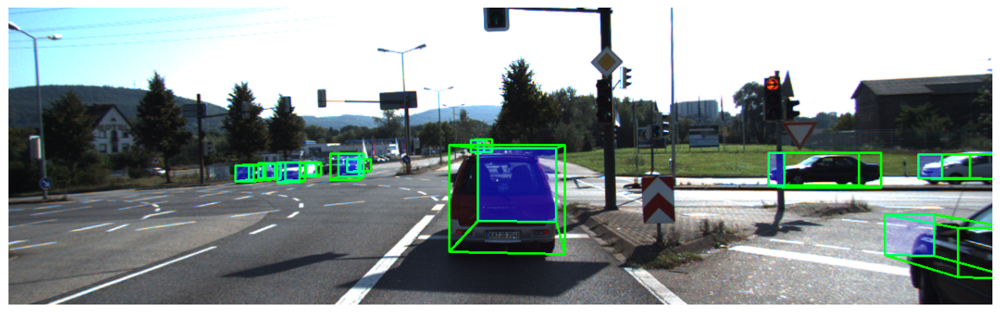

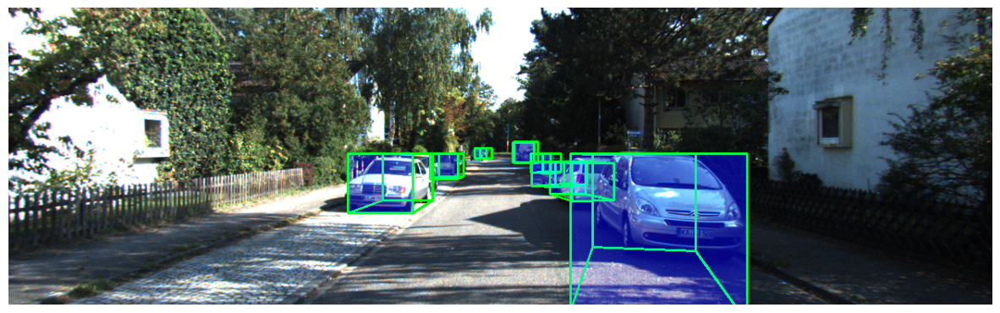

In [ ]:
import cv2
import matplotlib.pyplot as plt

img = cv2.cvtColor(cv2.imread('/content/YOLO3D/runs02/000.png'), cv2.COLOR_BGR2RGB)
plt.figure(figsize=(15, 8))
plt.imshow(img)
plt.axis('off')
plt.show()
img = cv2.cvtColor(cv2.imread('/content/YOLO3D/runs02/001.png'), cv2.COLOR_BGR2RGB)
plt.figure(figsize=(15, 8))
plt.imshow(img)
plt.axis('off')
plt.show()
img = cv2.cvtColor(cv2.imread('/content/YOLO3D/runs02/002.png'), cv2.COLOR_BGR2RGB)
plt.figure(figsize=(15, 8))
plt.imshow(img)
plt.axis('off')
plt.show()

## Test the Resnet-18 Model on KITTI Testing set

In [13]:
!python inference.py \
  --weights yolov5s.pt \
  --source dataset/KITTI/testing/image_2/ \
  --reg_weights resnet18.pkl \
  --model_select resnet18 \
  --output_path kitti_test \
  --save_result

Streaming output truncated to the last 5000 lines.
Speed: 0.4ms pre-process, 11.5ms inference, 1.6ms NMS per image at shape (1, 3, 640, 640)
YOLOv5 🚀 bce4c23 torch 1.8.1+cu102 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/YOLO3D/dataset/KITTI/testing/image_2/005017.png: 224x640 4 cars, Done. (0.013s)
Speed: 0.4ms pre-process, 12.5ms inference, 1.8ms NMS per image at shape (1, 3, 640, 640)
YOLOv5 🚀 bce4c23 torch 1.8.1+cu102 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/YOLO3D/dataset/KITTI/testing/image_2/005018.png: 224x640 3 cars, Done. (0.011s)
Speed: 0.4ms pre-process, 11.2ms inference, 1.8ms NMS per image at shape (1, 3, 640, 640)
YOLOv5 🚀 bce4c23 torch 1.8.1+cu102 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/

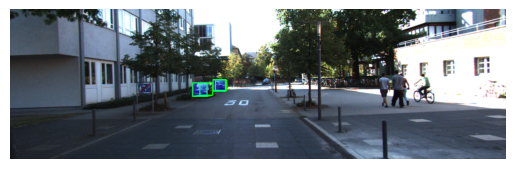

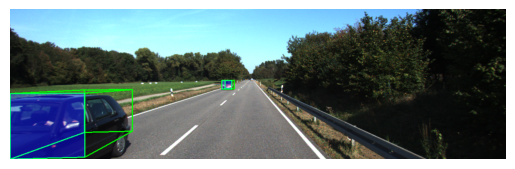

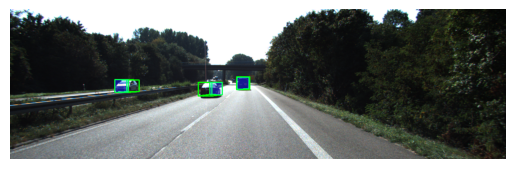

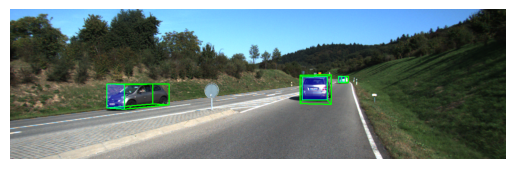

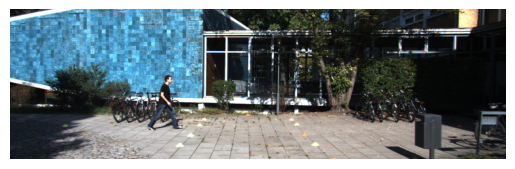

...

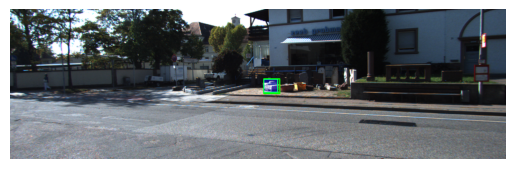

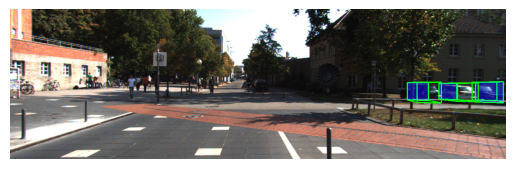

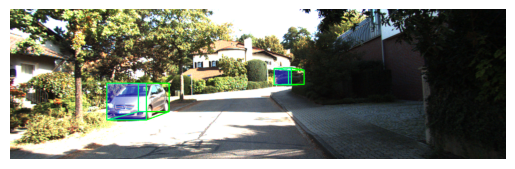

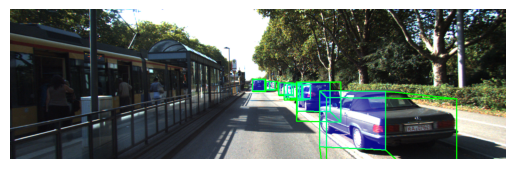

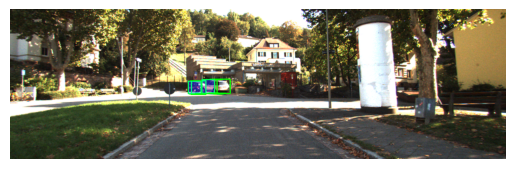

In [15]:
from google.colab.patches import cv2_imshow
all_image_paths = sorted(glob.glob('kitti_test/*.png'))
samples = min(100, len(all_image_paths))

for i in range(samples):
    j = random.randint(0,len(all_image_paths) - 1)
    image = cv2.imread(all_image_paths[j])
    plt.imshow(image[:, :, ::-1])
    plt.axis('off')
    plt.show()

# Run the Yolov5 weights on Video-1

In [ ]:
!curl -L "https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0002/2011_09_26_drive_0002_extract.zip" > video.zip
!unzip video.zip -d video/
!rm video.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  472M  100  472M    0     0  31.6M      0  0:00:14  0:00:14 --:--:-- 33.1M
Archive:  video.zip
   creating: video/2011_09_26/2011_09_26_drive_0002_extract/oxts/
 extracting: video/2011_09_26/2011_09_26_drive_0002_extract/oxts/timestamps.txt  
 extracting: video/2011_09_26/2011_09_26_drive_0002_extract/oxts/dataformat.txt  
   creating: video/2011_09_26/2011_09_26_drive_0002_extract/oxts/data/
 extracting: video/2011_09_26/2011_09_26_drive_0002_extract/oxts/data/0000000210.txt  
 extracting: video/2011_09_26/2011_09_26_drive_0002_extract/oxts/data/0000000145.txt  
 extracting: video/2011_09_26/2011_09_26_drive_0002_extract/oxts/data/0000000013.txt  
 extracting: video/2011_09_26/2011_09_26_drive_0002_extract/oxts/data/0000000166.txt  
 extracting: video/2011_09_26/2011_09_26_drive_0002_extract/oxts/data/0000000247.txt  
 extrac

In [ ]:
path = 'video/2011_09_26/2011_09_26_drive_0002_extract/image_01/data/0000000000.png'
image = cv2.imread(path)
print(image.shape)

(512, 1392, 3)


In [ ]:
for i in range(4):
  path = 'video/2011_09_26/2011_09_26_drive_0002_extract/image_0' + str(i) + '/data'
  out_path = f'kitti_runs_{i}'
  !python inference.py \
  --weights yolov5s.pt \
  --source {path} \
  --reg_weights resnet18.pkl \
  --model_select resnet18 \
  --output_path {out_path} \
  --save_result

inference: weights=['yolov5s.pt'], source=video/2011_09_26/2011_09_26_drive_0002_extract/image_00/data, data=data/coco128.yaml, imgsz=[640, 640], device=, classes=[0, 2, 3, 5], reg_weights=resnet18.pkl, model_select=resnet18, calib_file=eval/camera_cal/calib_cam_to_cam.txt, show_result=False, save_result=True, output_path=kitti_runs_0
YOLOv5 🚀 bce4c23 torch 1.8.1+cu102 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/YOLO3D/video/2011_09_26/2011_09_26_drive_0002_extract/image_00/data/0000000000.png: 256x640 2 persons, 3 cars, Done. (0.008s)
Speed: 0.3ms pre-process, 8.1ms inference, 1.6ms NMS per image at shape (1, 3, 640, 640)
YOLOv5 🚀 bce4c23 torch 1.8.1+cu102 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/YOLO3D/video/2011_09_26/2011_09_26_drive_0002_extract/image_00/data/0000000001.png: 256x640 2 persons,

In [ ]:
for i in range(4):
    path = f'kitti_runs_{i}'
    output_video_file_path = f'video_{i}.mp4'
    all_image_paths = sorted(glob.glob(path + '/*.png'))

    frame_rate = 11
    frame_size = (1392, 512)
    video_writer = cv2.VideoWriter(output_video_file_path, cv2.VideoWriter_fourcc(*'DIVX'), frame_rate, frame_size)

    for image_path in all_image_paths:
        image = cv2.imread(image_path)
        video_writer.write(image)
    video_writer.release()

# Run the Yolov5 weights on Video-2

In [ ]:
!curl -L "https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0005/2011_09_26_drive_0005_extract.zip" > video.zip
!unzip video.zip -d video_2/
!rm video.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  932M  100  932M    0     0  28.3M      0  0:00:32  0:00:32 --:--:-- 28.2M
Archive:  video.zip
   creating: video_2/2011_09_26/2011_09_26_drive_0005_extract/oxts/
 extracting: video_2/2011_09_26/2011_09_26_drive_0005_extract/oxts/timestamps.txt  
 extracting: video_2/2011_09_26/2011_09_26_drive_0005_extract/oxts/dataformat.txt  
   creating: video_2/2011_09_26/2011_09_26_drive_0005_extract/oxts/data/
 extracting: video_2/2011_09_26/2011_09_26_drive_0005_extract/oxts/data/0000001030.txt  
 extracting: video_2/2011_09_26/2011_09_26_drive_0005_extract/oxts/data/0000001169.txt  
 extracting: video_2/2011_09_26/2011_09_26_drive_0005_extract/oxts/data/0000000210.txt  
 extracting: video_2/2011_09_26/2011_09_26_drive_0005_extract/oxts/data/0000000145.txt  
 extracting: video_2/2011_09_26/2011_09_26_drive_0005_extract/oxts/data/000000

In [ ]:
path = 'video_2/2011_09_26/2011_09_26_drive_0005_extract/image_01/data/0000000000.png'
image = cv2.imread(path)
print(image.shape)

(512, 1392, 3)


In [ ]:
for i in range(4):
  path = 'video_2/2011_09_26/2011_09_26_drive_0005_extract/image_0' + str(i) + '/data'
  out_path = f'kitti_runs_2_{i}'
  !python inference.py \
  --weights yolov5s.pt \
  --source {path} \
  --reg_weights resnet18.pkl \
  --model_select resnet18 \
  --output_path {out_path} \
  --save_result

inference: weights=['yolov5s.pt'], source=video_2/2011_09_26/2011_09_26_drive_0005_extract/image_00/data, data=data/coco128.yaml, imgsz=[640, 640], device=, classes=[0, 2, 3, 5], reg_weights=resnet18.pkl, model_select=resnet18, calib_file=eval/camera_cal/calib_cam_to_cam.txt, show_result=False, save_result=True, output_path=kitti_runs_2_0
YOLOv5 🚀 bce4c23 torch 1.8.1+cu102 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/YOLO3D/video_2/2011_09_26/2011_09_26_drive_0005_extract/image_00/data/0000000000.png: 256x640 3 persons, 3 cars, Done. (0.009s)
Speed: 0.3ms pre-process, 9.5ms inference, 2.4ms NMS per image at shape (1, 3, 640, 640)
YOLOv5 🚀 bce4c23 torch 1.8.1+cu102 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/YOLO3D/video_2/2011_09_26/2011_09_26_drive_0005_extract/image_00/data/0000000001.png: 256x640 3 

In [ ]:
for i in range(4):
    path = f'kitti_runs_2_{i}'
    output_video_file_path = f'video_2_{i}.mp4'
    all_image_paths = sorted(glob.glob(path + '/*.png'))

    frame_rate = 11
    frame_size = (1392, 512)
    video_writer = cv2.VideoWriter(output_video_file_path, cv2.VideoWriter_fourcc(*'DIVX'), frame_rate, frame_size)

    for image_path in all_image_paths:
        image = cv2.imread(image_path)
        video_writer.write(image)
    video_writer.release()

# Run the Yolov5 weights on Video-3

In [ ]:
!curl -L "https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0018/2011_09_26_drive_0018_extract.zip" > video.zip
!unzip video.zip -d video_3/
!rm video.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 1600M  100 1600M    0     0  28.4M      0  0:00:56  0:00:56 --:--:-- 29.5M
Archive:  video.zip
   creating: video_3/2011_09_26/2011_09_26_drive_0018_extract/oxts/
 extracting: video_3/2011_09_26/2011_09_26_drive_0018_extract/oxts/timestamps.txt  
 extracting: video_3/2011_09_26/2011_09_26_drive_0018_extract/oxts/dataformat.txt  
   creating: video_3/2011_09_26/2011_09_26_drive_0018_extract/oxts/data/
 extracting: video_3/2011_09_26/2011_09_26_drive_0018_extract/oxts/data/0000001030.txt  
 extracting: video_3/2011_09_26/2011_09_26_drive_0018_extract/oxts/data/0000001169.txt  
 extracting: video_3/2011_09_26/2011_09_26_drive_0018_extract/oxts/data/0000000210.txt  
 extracting: video_3/2011_09_26/2011_09_26_drive_0018_extract/oxts/data/0000000145.txt  
 extracting: video_3/2011_09_26/2011_09_26_drive_0018_extract/oxts/data/000000

In [ ]:
path = 'video_3/2011_09_26/2011_09_26_drive_0018_extract/image_01/data/0000000000.png'
image = cv2.imread(path)
print(image.shape)

(512, 1392, 3)


In [ ]:
for i in range(4):
  path = 'video_3/2011_09_26/2011_09_26_drive_0018_extract/image_0' + str(i) + '/data'
  out_path = f'kitti_runs_3_{i}'
  !python inference.py \
  --weights yolov5s.pt \
  --source {path} \
  --reg_weights resnet18.pkl \
  --model_select resnet18 \
  --output_path {out_path} \
  --save_result

Streaming output truncated to the last 5000 lines.

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/YOLO3D/video_3/2011_09_26/2011_09_26_drive_0018_extract/image_00/data/0000000271.png: 256x640 1 car, 1 bus, Done. (0.013s)
Speed: 0.4ms pre-process, 12.9ms inference, 1.9ms NMS per image at shape (1, 3, 640, 640)
YOLOv5 🚀 bce4c23 torch 1.8.1+cu102 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/YOLO3D/video_3/2011_09_26/2011_09_26_drive_0018_extract/image_00/data/0000000272.png: 256x640 1 car, 1 bus, Done. (0.013s)
Speed: 0.4ms pre-process, 12.9ms inference, 1.9ms NMS per image at shape (1, 3, 640, 640)
YOLOv5 🚀 bce4c23 torch 1.8.1+cu102 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/YOLO3D/video_3/2011_09_26/2011_09_26_drive_0018_extract/image_00/da

In [ ]:
for i in range(4):
    path = f'kitti_runs_3_{i}'
    output_video_file_path = f'video_3_{i}.mp4'
    all_image_paths = sorted(glob.glob(path + '/*.png'))

    frame_rate = 11
    frame_size = (1392, 512)
    video_writer = cv2.VideoWriter(output_video_file_path, cv2.VideoWriter_fourcc(*'DIVX'), frame_rate, frame_size)

    for image_path in all_image_paths:
        image = cv2.imread(image_path)
        video_writer.write(image)
    video_writer.release()

# Run the Yolov5 weights on Video-4

In [ ]:
!curl -L "https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_29_drive_0026/2011_09_29_drive_0026_extract.zip" > video.zip
!unzip video.zip -d video_4/
!rm video.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  860M  100  860M    0     0  32.0M      0  0:00:26  0:00:26 --:--:-- 35.1M
Archive:  video.zip
   creating: video_4/2011_09_29/2011_09_29_drive_0026_extract/oxts/
 extracting: video_4/2011_09_29/2011_09_29_drive_0026_extract/oxts/timestamps.txt  
 extracting: video_4/2011_09_29/2011_09_29_drive_0026_extract/oxts/dataformat.txt  
   creating: video_4/2011_09_29/2011_09_29_drive_0026_extract/oxts/data/
 extracting: video_4/2011_09_29/2011_09_29_drive_0026_extract/oxts/data/0000001030.txt  
 extracting: video_4/2011_09_29/2011_09_29_drive_0026_extract/oxts/data/0000001169.txt  
 extracting: video_4/2011_09_29/2011_09_29_drive_0026_extract/oxts/data/0000000210.txt  
 extracting: video_4/2011_09_29/2011_09_29_drive_0026_extract/oxts/data/0000000145.txt  
 extracting: video_4/2011_09_29/2011_09_29_drive_0026_extract/oxts/data/000000

In [ ]:
path = 'video_4/2011_09_29/2011_09_29_drive_0026_extract/image_01/data/0000000000.png'
image = cv2.imread(path)
print(image.shape)

(512, 1392, 3)


In [ ]:
for i in range(4):
  path = 'video_4/2011_09_29/2011_09_29_drive_0026_extract/image_0' + str(i) + '/data'
  out_path = f'kitti_runs_4_{i}'
  !python inference.py \
  --weights yolov5s.pt \
  --source {path} \
  --reg_weights resnet18.pkl \
  --model_select resnet18 \
  --output_path {out_path} \
  --save_result

inference: weights=['yolov5s.pt'], source=video_4/2011_09_29/2011_09_29_drive_0026_extract/image_00/data, data=data/coco128.yaml, imgsz=[640, 640], device=, classes=[0, 2, 3, 5], reg_weights=resnet18.pkl, model_select=resnet18, calib_file=eval/camera_cal/calib_cam_to_cam.txt, show_result=False, save_result=True, output_path=kitti_runs_4_0
YOLOv5 🚀 bce4c23 torch 1.8.1+cu102 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/YOLO3D/video_4/2011_09_29/2011_09_29_drive_0026_extract/image_00/data/0000000000.png: 256x640 1 person, 4 cars, Done. (0.008s)
Speed: 0.3ms pre-process, 8.1ms inference, 1.7ms NMS per image at shape (1, 3, 640, 640)
YOLOv5 🚀 bce4c23 torch 1.8.1+cu102 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/YOLO3D/video_4/2011_09_29/2011_09_29_drive_0026_extract/image_00/data/0000000001.png: 256x640 1 p

In [ ]:
for i in range(4):
    path = f'kitti_runs_4_{i}'
    output_video_file_path = f'video_4_{i}.mp4'
    all_image_paths = sorted(glob.glob(path + '/*.png'))

    frame_rate = 11
    frame_size = (1392, 512)
    video_writer = cv2.VideoWriter(output_video_file_path, cv2.VideoWriter_fourcc(*'DIVX'), frame_rate, frame_size)

    for image_path in all_image_paths:
        image = cv2.imread(image_path)
        video_writer.write(image)
    video_writer.release()

# Run the Yolov5 weights on Video-5

In [ ]:
!curl -L "https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0106/2011_09_26_drive_0106_extract.zip" > video.zip
!unzip video.zip -d video_5/
!rm video.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 1317M  100 1317M    0     0  31.8M      0  0:00:41  0:00:41 --:--:-- 31.1M
Archive:  video.zip
   creating: video_5/2011_09_26/2011_09_26_drive_0106_extract/oxts/
 extracting: video_5/2011_09_26/2011_09_26_drive_0106_extract/oxts/timestamps.txt  
 extracting: video_5/2011_09_26/2011_09_26_drive_0106_extract/oxts/dataformat.txt  
   creating: video_5/2011_09_26/2011_09_26_drive_0106_extract/oxts/data/
 extracting: video_5/2011_09_26/2011_09_26_drive_0106_extract/oxts/data/0000001030.txt  
 extracting: video_5/2011_09_26/2011_09_26_drive_0106_extract/oxts/data/0000001169.txt  
 extracting: video_5/2011_09_26/2011_09_26_drive_0106_extract/oxts/data/0000000210.txt  
 extracting: video_5/2011_09_26/2011_09_26_drive_0106_extract/oxts/data/0000000145.txt  
 extracting: video_5/2011_09_26/2011_09_26_drive_0106_extract/oxts/data/000000

In [ ]:
path = 'video_5/2011_09_26/2011_09_26_drive_0106_extract/image_01/data/0000000000.png'
image = cv2.imread(path)
print(image.shape)

(512, 1392, 3)


In [ ]:
for i in range(4):
  path = 'video_5/2011_09_26/2011_09_26_drive_0106_extract/image_0' + str(i) + '/data'
  out_path = f'kitti_runs_5_{i}'
  !python inference.py \
  --weights yolov5s.pt \
  --source {path} \
  --reg_weights resnet18.pkl \
  --model_select resnet18 \
  --output_path {out_path} \
  --save_result

Streaming output truncated to the last 5000 lines.

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/YOLO3D/video_5/2011_09_26/2011_09_26_drive_0106_extract/image_00/data/0000000099.png: 256x640 9 cars, 2 motorcycles, Done. (0.008s)
Speed: 0.3ms pre-process, 8.1ms inference, 1.3ms NMS per image at shape (1, 3, 640, 640)
YOLOv5 🚀 bce4c23 torch 1.8.1+cu102 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/YOLO3D/video_5/2011_09_26/2011_09_26_drive_0106_extract/image_00/data/0000000100.png: 256x640 1 person, 9 cars, 1 motorcycle, Done. (0.008s)
Speed: 0.3ms pre-process, 8.2ms inference, 1.3ms NMS per image at shape (1, 3, 640, 640)
YOLOv5 🚀 bce4c23 torch 1.8.1+cu102 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/YOLO3D/video_5/2011_09_26/2011_09_26_drive

In [ ]:
for i in range(4):
    path = f'kitti_runs_5_{i}'
    output_video_file_path = f'video_5_{i}.mp4'
    all_image_paths = sorted(glob.glob(path + '/*.png'))

    frame_rate = 11
    frame_size = (1392, 512)
    video_writer = cv2.VideoWriter(output_video_file_path, cv2.VideoWriter_fourcc(*'DIVX'), frame_rate, frame_size)

    for image_path in all_image_paths:
        image = cv2.imread(image_path)
        video_writer.write(image)
    video_writer.release()

# Run the Yolov5 weights on Video-6

In [ ]:
!curl -L "https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_drive_0057/2011_09_26_drive_0057_extract.zip" > video.zip
!unzip video.zip -d video_6/
!rm video.zip

Streaming output truncated to the last 5000 lines.
 extracting: video_6/2011_09_26/2011_09_26_drive_0057_extract/oxts/data/0000002139.txt  
 extracting: video_6/2011_09_26/2011_09_26_drive_0057_extract/oxts/data/0000001907.txt  
 extracting: video_6/2011_09_26/2011_09_26_drive_0057_extract/oxts/data/0000002553.txt  
 extracting: video_6/2011_09_26/2011_09_26_drive_0057_extract/oxts/data/0000003275.txt  
 extracting: video_6/2011_09_26/2011_09_26_drive_0057_extract/oxts/data/0000000874.txt  
 extracting: video_6/2011_09_26/2011_09_26_drive_0057_extract/oxts/data/0000000202.txt  
 extracting: video_6/2011_09_26/2011_09_26_drive_0057_extract/oxts/data/0000000106.txt  
 extracting: video_6/2011_09_26/2011_09_26_drive_0057_extract/oxts/data/0000003657.txt  
 extracting: video_6/2011_09_26/2011_09_26_drive_0057_extract/oxts/data/0000001149.txt  
 extracting: video_6/2011_09_26/2011_09_26_drive_0057_extract/oxts/data/0000001822.txt  
 extracting: video_6/2011_09_26/2011_09_26_drive_0057_extra

In [ ]:
path = 'video_6/2011_09_26/2011_09_26_drive_0057_extract/image_01/data/0000000000.png'
image = cv2.imread(path)
print(image.shape)

(512, 1392, 3)


In [ ]:
for i in range(4):
  path = 'video_6/2011_09_26/2011_09_26_drive_0057_extract/image_0' + str(i) + '/data'
  out_path = f'kitti_runs_6_{i}'
  !python inference.py \
  --weights yolov5s.pt \
  --source {path} \
  --reg_weights resnet18.pkl \
  --model_select resnet18 \
  --output_path {out_path} \
  --save_result

Streaming output truncated to the last 5000 lines.
YOLOv5 🚀 bce4c23 torch 1.8.1+cu102 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/YOLO3D/video_6/2011_09_26/2011_09_26_drive_0057_extract/image_01/data/0000000267.png: 256x640 7 cars, Done. (0.008s)
Speed: 0.3ms pre-process, 8.1ms inference, 1.2ms NMS per image at shape (1, 3, 640, 640)
YOLOv5 🚀 bce4c23 torch 1.8.1+cu102 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/YOLO3D/video_6/2011_09_26/2011_09_26_drive_0057_extract/image_01/data/0000000268.png: 256x640 7 cars, Done. (0.008s)
Speed: 0.3ms pre-process, 8.1ms inference, 1.2ms NMS per image at shape (1, 3, 640, 640)
YOLOv5 🚀 bce4c23 torch 1.8.1+cu102 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model Summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/YOLO3D/video_6/201

In [ ]:
for i in range(4):
    path = f'kitti_runs_6_{i}'
    output_video_file_path = f'video_6_{i}.mp4'
    all_image_paths = sorted(glob.glob(path + '/*.png'))

    frame_rate = 11
    frame_size = (1392, 512)
    video_writer = cv2.VideoWriter(output_video_file_path, cv2.VideoWriter_fourcc(*'DIVX'), frame_rate, frame_size)

    for image_path in all_image_paths:
        image = cv2.imread(image_path)
        video_writer.write(image)
    video_writer.release()